# Are neighbourhoods with public transit in demand?
## An analysis of residential devleopment permits in Calgary

In this project, I look at a dataset released by the City of Calgary. It contains development permit application for the years 1979-2019. <br>
<b>The goal of the project is to compare communities with access to light rail transit (LRT) to communities without it.</b> Specifically, I would like to know whether these 'LRT communities' see more residenial development than 'non-LRT communities' <br>
<br>
To answer this question, I filtered out the residential developments in the dataset, and grouped them by neighbourhood, development type and year. Then, I visualised this data in two bar graphs and a map.<br>
<br>
Using the <b>bar graphs</b>, I found that there was no difference in the yearly growth rates between LRT communities and non-LRT communities. This was also true when I broke the numbers down into houses, apartment buildings and secondary suites. There was, however, a sharp overall increase in the number of secondary suites since 2018. This could reflect a change in the structure of Calgary's housing market.<br>
<br>
The <b>final map</b> shows the LRT lines as well as the number of residential developments per community. It confirmed that communities with direct LRT access do not see more residential development, but it also showed that the communities <i>around</i> the LRT do. This would suggest that proximity to rapid transit does actually positively affect residential developments. 

## Data cleaning
### Importing the data

In [1]:
import numpy as np
import pandas as pd
permits = pd.read_csv('data/Development_Permits.csv', low_memory=False)

### Exploring the data

In [2]:
permits.head(25)

,point,PermitNum,Address,Category,Description,ProposedUseCode,ProposedUseDescription,PermittedDiscretionary,LandUseDistrict,LandUseDistrictDescription,...,Longitude,LocationCount,LocationTypes,LocationAddresses,LocationsGeoJSON,LocationsWKT,City Quadrants,Ward Boundaries 2017,Ward Boundaries,Calgary Communities
0,POINT (-114.121644748052 51.0588329703014),DP2018-5532,2624 7 AV NW,Relaxation - Existing - Residential,RELAXATION: DECK (EXISTING) - PROJECTION INTO ...,C1455,DECK,Discretionary,R-C2,Residential - Contextual One/Two Dwelling,...,-114.121645,2.0,Titled Parcel;Building,2624 7 AV NW;2624 7 AV NW,"{""type"":""MultiPoint"",""coordinates"":[[-114.1216...",MULTIPOINT (-114.121644748052 51.0588329703014...,2.0,7.0,7.0,280.0
1,POINT (-114.1628542098241 51.07974632228047),DP2019-3976,5223 22 AV NW,Residential - New Single / Semi / Duplex,REVISION: SINGLE DETACHED DWELLING (RETAINING ...,C1020; C2730,ACCESSORY RESIDENTIAL BUILDING; SINGLE DETACHE...,Discretionary,R-C1,Residential - Contextual One Dwelling,...,-114.162854,1.0,Titled Parcel,5223 22 AV NW,"{""type"":""Point"",""coordinates"":[-114.1628542,51...",POINT (-114.1628542098241 51.07974632228047),2.0,7.0,13.0,24.0
2,POINT (-114.20481737847645 51.153588405935935),DP2019-4525,2 ROYAL VISTA LI NW,Commercial - Other Areas,"NEW: OFFICE, RETAIL AND CONSUMER SERVICE (3 BU...",C2110; C2515; C2680; C2690; C2700,OFFICE; RETAIL AND CONSUMER SERVICE; SIGN - CL...,Discretionary,I-B f1.0h24,Industrial - Business,...,-114.204817,1.0,Titled Parcel,2 ROYAL VISTA LI NW,"{""type"":""Point"",""coordinates"":[-114.2048174,51...",POINT (-114.20481737847645 51.153588405935935),2.0,9.0,3.0,157.0
3,POINT (-114.06914327122048 51.00394391815661),DP2016-0294,307 55 AV SW,Residential - Multi-Family,"NEW: ASSISTED LIVING (1 BUILDING, 135 RESIDENCES)",C1110,ASSISTED LIVING,Discretionary,DC,Direct Control (1P2007),...,-114.069143,1.0,Titled Parcel,307 55 AV SW,"{""type"":""Point"",""coordinates"":[-114.0691433,51...",POINT (-114.06914327122048 51.00394391815661),1.0,11.0,10.0,124.0
4,POINT (-113.88270351988479 50.89784906501635),DP2016-4777,17100 104 ST SE,Change of Use - With Change to Site Plan,TEMPORARY USE: VEHICLE STORAGE - RECREATIONAL ...,C2980,VEHICLE STORAGE - RECREATIONAL,Discretionary,S-FUD,Special Purpose - Future Urban Development,...,-113.882704,1.0,Titled Parcel,17100 104 ST SE,"{""type"":""Point"",""coordinates"":[-113.8827035,50...",POINT (-113.88270351988479 50.89784906501635),3.0,8.0,4.0,205.0
5,POINT (-113.97858984984752 51.17343558287692),DP2016-3398,300 BARLOW CR NE,Change of Use - With Change to Site Plan,CHANGES TO SITE PLAN: OTHER (PRIVATE ACCESS ROAD),C9999,OTHER,Discretionary,C-R3 f0.23h18,Commercial - Regional 3,...,-113.978590,3.0,Titled Parcel;Titled Parcel;Titled Parcel,13440R 36 ST NE;300 BARLOW CR NE;100 BARLOW CR NE,"{""type"":""MultiPoint"",""coordinates"":[[-113.9785...",MULTIPOINT (-113.97858984984752 51.17343558287...,4.0,1.0,11.0,6.0
6,POINT (-114.10044232606693 51.02870602760652),DP2016-3403,1710 28 AV SW,Residential - Multi-Family,NEW: MULTI-RESIDENTIAL DEVELOPMENT (2 BUILDING...,C2050,MULTI-RESIDENTIAL DEVELOPMENT,Discretionary,M-C1,Multi-Residential - Contextual Low Profile,...,-114.100442,1.0,Titled Parcel,1710 28 AV SW,"{""type"":""Point"",""coordinates"":[-114.1004423,51...",POINT (-114.10044232606693 51.02870602760652),1.0,2.0,14.0,207.0
7,POINT (-114.06939124901527 51.05274350438137),DP2017-2972,404 2 AV SW,Change of Use - With Change to Site Plan,REVISION: PLAZA LANDSCAPING IN FLOOD FRINGE,B9997,OTHER COMMERCIAL,Discretionary,DC,DIRECT CONTROL DISTRICT ...,...,-114.069391,2.0,Titled Parcel;Titled Parcel,139 BARCLAY PR SW;404 2 AV SW,"{""type"":""MultiPoint"",""coordinates"":[[-114.0693...",MULTIPOINT (-114.06939124901527 51.05274350438...,1.0,7.0,7.0,295.0
8,POINT (-114.13530835885037 51.03424001568322),DP2017-3114,2212 33 ST SW,Residential - Contextual Dwelling,"NEW: CONTEXTUAL SEMI-DETACHED DWELLING, ACCESS...",C1020; C1368,ACCESSORY RESIDENTIAL BUILDI

In [3]:
permits.columns

Index(['point', 'PermitNum', 'Address', 'Category', 'Description',
       'ProposedUseCode', 'ProposedUseDescription', 'PermittedDiscretionary',
       'LandUseDistrict', 'LandUseDistrictDescription', 'Concurrent LOC',
       'StatusCurrent', 'AppliedDate', 'DecisionDate', 'ReleaseDate',
       'MustCommenceDate', 'CanceledRefusedDate', 'Decision', 'DecisionBy',
       'SDABNumber', 'SDABHearingDate', 'SDABDecision', 'SDABDecisionDate',
       'CommunityCode', 'CommunityName', 'Ward', 'Quadrant', 'Latitude',
       'Longitude', 'LocationCount', 'LocationTypes', 'LocationAddresses',
       'LocationsGeoJSON', 'LocationsWKT', 'City Quadrants',
       'Ward Boundaries 2017', 'Ward Boundaries', 'Calgary Communities'],
      dtype='object')

In [4]:
permits.shape

(137529, 38)

### Selecting relevant columns 

To decide which data is most useful for this analysis I will look into various columns. Based on my goal, the most relevant columns seem to be:
- 'DecisionDate',
- 'Decision',
- 'Address',
- 'CommunityName',
- 'Latitude',
- 'Longitude',
- and <b>one</b> of: 'Category', 'Description', 'ProposedUseDescription'.

With these columns alone I can already get information about a development's year, its location and its type (i.e. residential vs. commercial). Several columns could have useful information about a development's type: 'Category', 'Description', 'ProposedUseDescription'. In the following code, I will explore each of these columns and decide which one to use. 

In [5]:
# Exploring the 'Category' column

def abs_rel_value_counts(df, col):
    """Combines relative and absolute value counts in one dataframe"""
    relative = df[col].value_counts(dropna=False, normalize=True)
    absolute = df[col].value_counts(dropna=False)
    comb = pd.concat([relative, absolute], keys=['relative', 'absolute'], axis=1)
    return comb
    
category_counts = abs_rel_value_counts(permits, 'Category')
category_counts.head()

,relative,absolute
NaN,0.411477,56590
Relaxation - Existing - Residential,0.107221,14746
Change of Use - Discretionary Use or Relaxations Required,0.056010,7703
Residential - New Single / Semi / Duplex,0.052847,7268
Home Occupation Class 2,0.049502,6808


The <b>Category</b> column has <b>too many missing values</b> to be useful for this analysis. I will check out the <b>Description</b> column next.

In [6]:
# Exploring the 'Description' column.

description_counts = abs_rel_value_counts(permits, 'Description')
description_counts

,relative,absolute
CONVERTED JOB - REAR DRIVE RELAXATION FOR EXISTING GARAGE,0.013430,1847
NEW: SINGLE DETACHED DWELLING,0.011154,1534
RELAXATION OF EXISTING STRUCTURE (RESIDENTIAL),0.010245,1409
CONVERTED JOB - SIDE YARD RELAXATION FOR EXISTING DWELLING,0.009976,1372
CONVERTED JOB - REAR YARD RELAXATION FOR EXISTING DECK,0.008878,1221
CONVERTED JOB - SIDE YARD RELAXATION FOR EXISTING DECK,0.007613,1047
REAR YARD RELAXATION FOR EXISTING DECK,0.007460,1026
CHANGE OF USE: GENERAL INDUSTRIAL - LIGHT,0.007293,1003
NEW: SIGN - CLASS B (FASCIA SIGN),0.007235,995
SINGLE DETACHED DWELLING,0.007053,970


The <b>Description</b> column has 58189 unique categories, and the category with the highest frequency makes up only ~1% of the data. This columnd will <b>not be useful</b> for my analysis.

In [7]:
# Exploring the 'ProposedUseDescription' column.

use_counts = abs_rel_value_counts(permits, 'ProposedUseDescription')
use_counts

,relative,absolute
SINGLE-DETACHED DWELLING,0.196955,27087
HOME OCCUPATION - CLASS 2,0.071847,9881
SINGLE DETACHED DWELLING,0.052193,7178
ACCESSORY BUILDING,0.046608,6410
SIGN,0.041562,5716
HOME OCCUPATION,0.040479,5567
DECK,0.038865,5345
SIGN - CLASS B,0.023610,3247
SEMI-DETACHED DWELLING,0.022933,3154
ACCESSORY RESIDENTIAL BUILDING,0.019312,2656


The <b>ProposedUseType</b> column, still has 2474 unique categories, but many appear to have only few entries. It may be possible to drop these without compromising the analysis. I will go ahead and look at the frequency of each category in this column.

In [8]:
# Filtering for categories that each make up less than .1% of the data. 

use_counts_low = use_counts[use_counts.relative < 0.001]
use_counts_low

,relative,absolute
NEIGHBORHOOD SHOPPING CENTRE,0.000967,133
OUTSIDE STORAGE,0.000960,132
COMMUNITY ASSOCIATION BUILDING,0.000931,128
SPECIALTY FOOD STORE,0.000916,126
MEDICAL CLINIC; RETAIL AND CONSUMER SERVICE,0.000909,125
PLACE OF WORSHIP - SMALL,0.000902,124
AIR CONDITIONING EQUIPMENT; DECK,0.000894,123
PARKING AREA (TEMPORARY),0.000873,120
BEAUTY AND BODY SERVICE,0.000858,118
BUSINESS OR COMMERCIAL ESTABLISHMENT,0.000851,117


<b>Conclusion</b>: 4% of categories in the <b>ProposedUseType</b> column cover 90% of the data

It appears that 2371 categories (out of the total 2474 unique categories) make up only ~10% of the data. <b>This means that the analysis can be narrowed down to a much more manageable 100 or so categories</b>, and still use ~90% of the data. That appears to be a good compromise, hence I will proceed to use the <b>ProposedUseType</b> column for this analysis. <br><br>In the following code I will:
- select only our columns of interest, 
- select only residential developments, 
- group the residential developments into a more mangeable number of meaningful categories. 

In [9]:
# Selecting the columns.

permits_cols = permits[['Address','ProposedUseDescription','DecisionDate','Decision','CommunityName','Latitude','Longitude']]
permits_cols

,Address,ProposedUseDescription,DecisionDate,Decision,CommunityName,Latitude,Longitude
0,2624 7 AV NW,DECK,NaN,NaN,WEST HILLHURST,51.058833,-114.121645
1,5223 22 AV NW,ACCESSORY RESIDENTIAL BUILDING; SINGLE DETACHE...,2019/09/12,Approval,MONTGOMERY,51.079746,-114.162854
2,2 ROYAL VISTA LI NW,OFFICE; RETAIL AND CONSUMER SERVICE; SIGN - CL...,NaN,NaN,ROYAL VISTA,51.153588,-114.204817
3,307 55 AV SW,ASSISTED LIVING,2016/11/25,Approval,MANCHESTER,51.003944,-114.069143
4,17100 104 ST SE,VEHICLE STORAGE - RECREATIONAL,2018/03/29,Approval,RESIDUAL WARD 12 - SUB AREA 12J,50.897849,-113.882704
5,300 BARLOW CR NE,OTHER,2018/03/07,Approval,STONEGATE LANDING,51.173436,-113.978590
6,1710 28 AV SW,MULTI-RESIDENTIAL DEVELOPMENT,2017/07/06,Approval,SOUTH CALGARY,51.028706,-114.100442
7,404 2 AV SW,OTHER COMMERCIAL,2018/01/11,Approval,EAU CLAIRE,51.052744,-114.069391
8,2212 33 ST SW,ACCESSORY RESIDENTIAL BUILDING; CONTEXTUAL SEM...,2017/09/29,Approval,KILLARNEY/GLENGARRY,51.034240,-114.135308
9,7311 36 AV NW,SINGLE-DETACHED DWELLING,2001/08/16,Approval,NaN,NaN,NaN


### Isolating residential permits

In [10]:
# Removing entries in low frequency categories (less than .1% of the data per category)

low_freq_cat = list(use_counts_low.index)

def tag_row(row):
    """Tags rows on low frequency categories for removal"""
    if row['ProposedUseDescription'] in low_freq_cat:
        row['ProposedUseDescription'] = False
    return row

permits_select = permits_cols.apply(tag_row, axis=1)

permits_select = permits_select[permits_select.ProposedUseDescription != False]

# Checking the categories after I removed low frequency categories.

permits_select['ProposedUseDescription'].unique()

array(['DECK', 'ACCESSORY RESIDENTIAL BUILDING; SINGLE DETACHED DWELLING',
       'OTHER', 'MULTI-RESIDENTIAL DEVELOPMENT', 'OTHER COMMERCIAL',
       'ACCESSORY RESIDENTIAL BUILDING; CONTEXTUAL SEMI-DETACHED DWELLING',
       'SINGLE-DETACHED DWELLING', 'SIGN',
       'ACCESSORY RESIDENTIAL BUILDING; SEMI-DETACHED DWELLING',
       'SINGLE DETACHED DWELLING',
       'ACCESSORY RESIDENTIAL BUILDING; MULTI-RESIDENTIAL DEVELOPMENT',
       'BACKYARD SUITE', nan,
       'ACCESSORY BUILDING; SEMI-DETACHED DWELLING',
       'ACCESSORY RESIDENTIAL BUILDING; CONTEXTUAL SINGLE DETACHED DWELLING',
       'SCHOOL AUTHORITY - SCHOOL', 'FENCE', 'GENERAL INDUSTRIAL - LIGHT',
       'EXISTING NON-CONFORMING', 'GENERAL INDUSTRIAL - MEDIUM',
       'SECONDARY SUITE', 'SEMI-DETACHED DWELLING', 'OFFICE',
       'HOME OCCUPATION - CLASS 2', 'HOME BASED CHILD CARE - CLASS 2',
       'RETAINING WALL', 'CHILD CARE SERVICE',
       'ACCESSORY RESIDENTIAL BUILDING', 'DECK; SINGLE DETACHED DWELLING',
       'S

In [11]:
# Indexing rows with relevant categories

categories = ['MULTI-RESIDENTIAL DEVELOPMENT',
'SINGLE DETACHED DWELLING',
'BACKYARD SUITE',
'SECONDARY SUITE', 'SEMI-DETACHED DWELLING',
'CONTEXTUAL SINGLE DETACHED DWELLING',
'FOURPLEX DWELLING',
'TOWNHOUSES',
'APARTMENT BUILDING',
'DUPLEX DWELLING',
'CONTEXTUAL SEMI-DETACHED DWELLING']

matches = [permits_select['ProposedUseDescription'].str.match(c) for c in categories]   # Create list of lists
boolean_any = pd.DataFrame(matches).any()    # Convert to df, reduce to series for indexin
permits_res = permits_select[boolean_any].reset_index()

In [12]:
# Checking value counts of updated df
prop_use_counts = abs_rel_value_counts(permits_res, 'ProposedUseDescription')
prop_use_counts

,relative,absolute
SINGLE DETACHED DWELLING,0.409961,7178
SEMI-DETACHED DWELLING,0.180136,3154
SECONDARY SUITE,0.127078,2225
MULTI-RESIDENTIAL DEVELOPMENT,0.064253,1125
APARTMENT BUILDING,0.062025,1086
CONTEXTUAL SINGLE DETACHED DWELLING,0.049803,872
TOWNHOUSES,0.046947,822
DUPLEX DWELLING,0.024616,431
FOURPLEX DWELLING,0.015021,263
CONTEXTUAL SEMI-DETACHED DWELLING,0.010166,178


<b>For the purpose of this analysis the remaining 11 categories will be grouped together into broader categories:</b>

- 'MULTI-RESIDENTIAL DEVELOPMENT', 'FOURPLEX DWELLING', 'APARTMENT BUILDING', 'DUPLEX DWELLING' <br>will be grouped as 'Multi_unit'

- 'SINGLE DETACHED DWELLING', 'CONTEXTUAL SEMI-DETACHED DWELLING', 'TOWNHOUSES', 'SEMI-DETACHED DWELLING', 'CONTEXTUAL SINGLE DETACHED DWELLING' <br>will be grouped as 'House'

- 'BACKYARD SUITE', 'SECONDARY SUITE' <br>will be grouped as 'Secondary_suite'

In [13]:
# Re-grouping

grouping_dict = {}
grouping_dict.update(dict.fromkeys(['BACKYARD SUITE', 'SECONDARY SUITE'], 'Secondary_suite'))
grouping_dict.update(dict.fromkeys(['MULTI-RESIDENTIAL DEVELOPMENT', 'FOURPLEX DWELLING', 'APARTMENT BUILDING', 'DUPLEX DWELLING'], 'Multi_unit'))
grouping_dict.update(dict.fromkeys(['SINGLE DETACHED DWELLING', 'CONTEXTUAL SEMI-DETACHED DWELLING', 'TOWNHOUSES', 'SEMI-DETACHED DWELLING', 'CONTEXTUAL SINGLE DETACHED DWELLING'], 'House'))
print(grouping_dict)

permits_res['Category_new'] = permits_res['ProposedUseDescription'].map(grouping_dict)
cat_new_count = abs_rel_value_counts(permits_res, 'Category_new')

cat_new_count

{'BACKYARD SUITE': 'Secondary_suite', 'SECONDARY SUITE': 'Secondary_suite', 'MULTI-RESIDENTIAL DEVELOPMENT': 'Multi_unit', 'FOURPLEX DWELLING': 'Multi_unit', 'APARTMENT BUILDING': 'Multi_unit', 'DUPLEX DWELLING': 'Multi_unit', 'SINGLE DETACHED DWELLING': 'House', 'CONTEXTUAL SEMI-DETACHED DWELLING': 'House', 'TOWNHOUSES': 'House', 'SEMI-DETACHED DWELLING': 'House', 'CONTEXTUAL SINGLE DETACHED DWELLING': 'House'}


,relative,absolute
House,0.697013,12204
Multi_unit,0.165915,2905
Secondary_suite,0.137072,2400


The dataset now contains <b>only residential permits in three intuitive categories</b>: Houses, multi-unit buildings, secondary suites. <br>I will move on to checking and filling in location data, where necessary.

### Cleaning location data of residential permits

In [14]:
permits_res.shape

(17509, 9)

In [15]:
permits_res.isnull().sum()

index                        0
Address                      7
ProposedUseDescription       0
DecisionDate              1507
Decision                  1439
CommunityName              150
Latitude                   150
Longitude                  150
Category_new                 0
dtype: int64

There are 7 rows with missing adresses and 150 rows with missing community names and latitude/longitude info. Below, I will attempt to fill the missing data.<br><br>
<b>The most essential information for this analysis is the 'CommunityName'.</b>
<br>Unfortunately, it is not included in the 'Address' column. I can, however, obtain the community name using the Nomatim geodata API. These are the steps involved: 
- Look up the address to get Latitude/Longitude coordinates, 
- look uo the coordinates to get an address string WITH the community name included, 
- extract the community name using regular expressions.

(N.B.: The Nominatim API was specifically chosen because it includes the community in the address. The faster APIs that I tested, e.g. Google's, don't do this unfortunately.)

Unfortunately, if both the coordinates and the address are missing, I have to remove the row in question.

In [16]:
# Removing rows where both latitude/longitude and address are null

lat_ad_null = permits_res.index[(permits_res.Latitude.isnull()) & (permits_res.Address.isnull())]
permits_res.drop(lat_ad_null, inplace=True)
permits_res.isnull().sum()

index                        0
Address                      0
ProposedUseDescription       0
DecisionDate              1503
Decision                  1436
CommunityName              143
Latitude                   143
Longitude                  143
Category_new                 0
dtype: int64

In [17]:
# Exploring the format of addresses used for lookup of latitude/longitude coordinates

lat_null = permits_res.index[permits_res['Latitude'].isnull()]
print(permits_res.loc[lat_null, 'Address'])

62                   1934 25 ST SW
207                   2350 5 ST SW
803              6827 CENTRE ST NW
804                  2805 29 ST SW
805                   228 26 AV SW
806                   2608 4 AV NW
807                   539 51 AV SW
809                  1815 26 AV SW
810            10 BRIDLEWOOD VW SW
811                  2508 21 AV SW
812                  2035 28 AV SW
813                  2201 32 AV SW
814      102 DISCOVERY RIDGE RD SW
815                  1811 34 AV SW
817                  2424 36 ST SW
819                  4015 18 ST SW
820              627 CITADEL WY NW
821                   626 27 AV NE
822                   735 23 AV NW
823                  1051 85 ST SW
824             111 TARAWOOD LN NE
825                  3620 1A ST SW
829                  2239 28 ST SW
848                  2239 28 ST SW
892            701 MCDOUGALL RD NE
901                   2201 7 AV NW
1053                  436 20 AV NE
1055                 2116 32 AV SW
1073                

In [18]:
# The addresses are ambiguous because no city info is included. 
# Addresses will be appended before passing them to the API. 

# Adding longitude/latitude values where missing

import geopy as g
geocoder = g.geocoders.Nominatim(user_agent = 'CMW', timeout=None)

for i in lat_null:
    address = permits_res.at[i, 'Address'] + ', Calgary, Alberta, Canada'
    location = geocoder.geocode(address)
    
    if location is None:
        continue
    else:
        permits_res.at[i, 'Latitude'] = location.latitude
        permits_res.at[i, 'Longitude'] = location.longitude

In [19]:
permits_res.isnull().sum()

index                        0
Address                      0
ProposedUseDescription       0
DecisionDate              1503
Decision                  1436
CommunityName              143
Latitude                    11
Longitude                   11
Category_new                 0
dtype: int64

In some cases, the geocoder could not find an appropriate address,and therefore no longitude/latitude values were added. 
<br><br>These rows will now be removed from the dataset.

In [20]:
# Removing unfilled latitude/longitude data

lat_null_new = permits_res.index[permits_res.Latitude.isnull()]
permits_res.drop(lat_null_new, inplace=True)
permits_res.isnull().sum()

index                        0
Address                      0
ProposedUseDescription       0
DecisionDate              1502
Decision                  1435
CommunityName              132
Latitude                     0
Longitude                    0
Category_new                 0
dtype: int64

All latitude/longitude fields have been filled. Now, I will use them to look up addresses, and store the addresses in a dictionary for further processing. The community name will then be extracted from the address and stored in a separate dictionary. Finally, the dictionary containing the community name will be used to fill the missing data. 

In [21]:
# Looking up addresses from coordinates

index_address = {}

comm_null = permits_res.index[permits_res['CommunityName'].isnull()]

for i in comm_null:
    lat = permits_res.at[i,'Latitude']
    lon = permits_res.at[i,'Longitude']
    location = geocoder.reverse((lat, lon), exactly_one=True)
    index_address[i] = location.address

In [22]:
# Extracting community name from addresses stored in index_address dictionary

import re
regex = r",\s([\w\.*\s*/*\w*]+),\sCalgary"

index_comm = {}

for i in comm_null:
    string_ad = index_address[i]
    try:
        community = re.search(regex, string_ad).group(1)
    except:
        print(i + ' <- search did not work')
        continue
    index_comm[i] = community
    
index_comm

{62: 'Shaganappi',
 207: 'Eau Claire',
 803: 'Huntington Hills',
 804: 'Killarney/Glengarry',
 805: 'Mission',
 806: 'Sunnyside',
 807: 'North Glenmore',
 809: 'Killarney/Glengarry',
 810: 'Bridlewood',
 811: 'Bankview',
 812: 'Glenbrook',
 813: 'Rutland Park',
 814: 'Discovery Ridge',
 815: 'South Calgary',
 817: 'Spruce Cliff',
 819: 'Sunalta',
 820: 'Citadel',
 821: 'Sunridge',
 822: 'Banff Trail',
 823: 'Aspen Woods',
 824: 'Taradale',
 825: 'Parkhill/Stanley Park',
 829: 'Shaganappi',
 848: 'Shaganappi',
 892: 'Bridgeland/Riverside',
 901: 'Crescent Heights',
 1053: 'Sunridge',
 1055: 'Rutland Park',
 1073: 'Glenbrook',
 1127: 'Collingwood',
 1140: 'Rosscarrock',
 1148: 'West Hillhurst',
 1173: 'Christie Park',
 1198: 'Discovery Ridge',
 1308: 'Point McKay',
 1353: 'Point McKay',
 1428: 'Mission',
 1429: 'Country Hills',
 1460: 'Mission',
 1464: 'Forest Lawn Industrial',
 1494: 'Spruce Cliff',
 1613: 'Somerset',
 1643: 'Ogden',
 1712: 'Westgate',
 1914: 'Shaganappi',
 2066: 'Shaga

In [23]:
# Filling missing community names with the index_comm dictionary
permits_res['CommunityName'].fillna(index_comm, inplace=True)
print(permits_res.loc[1148, 'CommunityName'],
      permits_res.loc[2657, 'CommunityName'],
      permits_res.loc[4635, 'CommunityName'])

West Hillhurst Beddington Heights St. Andrews Heights


In [24]:
# All community names have been filled. The lookup returned community names
# that are lowercase, so I will convert them to uppercase now.

permits_res['CommunityName'] = permits_res['CommunityName'].apply(lambda x: x.upper())

# Checking for invalid community names

permits_res['CommunityName'].unique()

array(['SOUTH CALGARY', 'SADDLE RIDGE', 'PARKDALE', 'MARLBOROUGH',
       'BELTLINE', 'MOUNT PLEASANT', 'BELMONT', 'RENFREW',
       'WEST HILLHURST', 'WOODBINE', 'BRIDLEWOOD', 'NORTH GLENMORE PARK',
       'BANFF TRAIL', 'RICHMOND', 'HILLHURST', 'MAHOGANY', 'INGLEWOOD',
       'GLAMORGAN', 'MARLBOROUGH PARK', 'BRIDGELAND/RIVERSIDE',
       'SAGE HILL', 'PANORAMA HILLS', 'BEDDINGTON HEIGHTS', 'TEMPLE',
       'DALHOUSIE', 'MARTINDALE', 'PENBROOKE MEADOWS', 'FOREST LAWN',
       'LEGACY', 'BAYVIEW', 'ALTADORE', 'REDSTONE', 'ROSEDALE',
       'EVANSTON', 'SKYVIEW RANCH', 'HIGHWOOD', 'CITADEL', 'WHITEHORN',
       'TUSCANY', 'BRENTWOOD', 'STRATHCONA PARK', 'SCARBORO',
       'SHAWNEE SLOPES', 'VALLEY RIDGE', 'SHAGANAPPI', 'OAKRIDGE',
       'ASPEN WOODS', 'TARADALE', 'ROSEMONT', 'DOVER', 'EVERGREEN',
       'CARRINGTON', 'DOUGLASDALE/GLEN', 'ROYAL OAK', 'WOODLANDS',
       'BOWNESS', 'ELBOYA', 'COACH HILL', 'THORNCLIFFE',
       'HUNTINGTON HILLS', 'VARSITY', 'PARKHILL', 'CHARLESWOOD',
  

In [25]:
# These community names are either ambiguous or refer to electoral district rather than neighbourhood

invalid_comm = ['RESIDUAL WARD 14 - SUB AREA 14U', 'RESIDUAL WARD 1 - SUB AREA 01F', 
                'RESIDUAL WARD 12 - SUB AREA 12A', 'RESIDUAL WARD 12 - SUB AREA 12B',
                'RESIDUAL WARD 10 - SUB AREA 10E', 'RESIDUAL WARD 12 - SUB AREA 12C']

# Removing entries with invalid community names

permits_res_comm = permits_res.copy()

for index, row in permits_res_comm.iterrows():
    if row['CommunityName'] in invalid_comm:
        permits_res_comm.drop(index, inplace=True)        

Now, all entries have all the requires location data.<br>
<b>Next, I need to add information about whether the development is in a community with LRT access or not.</b><br>
To do this, I will add a column 'CTrain'.

In [26]:
# Creating a list with all the communities that have CTrain access

ctrain_comms = ['MANCHESTER', 'BANFF TRAIL', 'MARLBOROUGH', 'HILLHURST', 'BELTLINE',
            'SADDLE RIDGE', 'BRIDGELAND/RIVERSIDE', 'ALBERT PARK/RADISSON HEIGHTS', 'SCARBORO', 'CAPITOL HILL',
            'PARKHILL', 'GLENDALE', 'CHARLESWOOD', 'SHAGANAPPI', 'SHAWNEE SLOPES',
            'SPRUCE CLIFF', 'SUNNYSIDE', 'DALHOUSIE', 'SUNALTA', 'ROSSCARROCK', 'VARSITY', 'HOUNSFIELD HEIGHTS/BRIAR HILL',
            'ERLTON', 'SCARBORO/SUNALTA WEST', 'RUNDLE', 'WESTGATE', 'LAKE BONAVISTA', 
            'TUSCANY', 'BRENTWOOD', 'MIDNAPORE', 'EAU CLAIRE', 'WHITEHORN', 'CHINATOWN',
            'CANYON MEADOWS', 'MARTINDALE', 'HAYSBORO', 'SHAWNESSY', 'DOWNTOWN EAST VILLAGE',
            'CHRISTIE PARK', 'SCENIC ACRES', 'DOWNTOWN EAST VILLAGE', 'DOWNTOWN WEST END', 'DOWNTOWN COMMERCIAL CORE']

# Adding CTrain column

for index, row in permits_res_comm.iterrows():
    if row['CommunityName'] in ctrain_comms:
        permits_res_comm.at[index, 'CTrain'] = True
    else:
        permits_res_comm.at[index, 'CTrain'] = False
        
# Checking how many entries have been labelled as being in a CTrain community

permits_res_comm['CTrain'].sum()

4162

Now that the community names have been fixed and information about CTrain access has been added, I will:
- remove entries without a date,
- extract the year of the permit from the date column.

In [27]:
# Dropping columns with no date

permits_res_comm_date = permits_res_comm.dropna(subset=['DecisionDate'])

# Extracting year of approval

year_regex = r"(\d+)/"
permits_res_comm_yr = permits_res_comm_date.copy()
permits_res_comm_yr['Year'] = permits_res_comm_date['DecisionDate'].str.extract(year_regex).astype(int)

# Checking distribution of the Year data

year_counts = permits_res_comm_yr['Year'].value_counts(dropna=False)
year_counts

2019    1493
2012    1032
2018    1026
2011     996
2015     992
2014     980
2010     959
2009     921
2013     852
2008     813
2017     780
2016     777
2003     341
2002     328
2006     311
2004     310
2007     310
2005     304
2000     291
2001     285
1998     256
1999     248
1997     183
1994     169
1990     165
1992     162
1991     158
1996     125
1993     118
1995     115
1989      78
1981      48
1982      29
1983       9
1980       5
1988       5
1984       4
1987       3
1986       2
1979       2
1985       2
Name: Year, dtype: int64

In [28]:
# Checking for entries before 1990

year_counts[year_counts.index<1990].sum()

187

There is <b>very little data for the years before 1990</b>, so I will only keep entries with years after 1989.

In [29]:
# Selecting entries after 1990

permits_res_comm_90 = permits_res_comm_yr[permits_res_comm_yr.Year > 1989].drop(['index'], axis=1)

# Commented for future use
# # Saving the final cleaned version of permits_res

# permits_res_comm_90.to_csv('data/permits_res_final.csv')

In [30]:
# permits_res_comm_90 = pd.read_csv('data/permits_res_final.csv', index_col=0)
# permits_res_comm_90.head()

## Analysis
### Fig. 1: Yearly growth rates

Now that I have cleaned my data, I can <b>proceed with the analysis.</b><br>
I will start by looking into the yearly growth rates in communities with transit access vs communities without.<br>
To do this, the data has to be summarised in the format: CTrain Yes/No → Year → # of permits.

In [31]:
# Grouping by CTrain (LRT) access

grouped = permits_res_comm_90.groupby(['CTrain', 'Year'])
yr_counts = grouped.count()['Decision'].rename('Permit_no', inplace=True)

In [32]:
# Converting counts to rates, then to %

rates = (yr_counts/yr_counts.shift(1)) - 1
rates = rates * 100
rates.drop([(False,1990), (True,1990)], inplace=True)

rates.rename('% change', inplace=True)
rates

CTrain  Year
False   1991     -5.645161
        1992      1.709402
        1993    -32.773109
        1994     62.500000
        1995    -38.461538
        1996     22.500000
        1997     36.734694
        1998     38.059701
        1999     -1.621622
        2000     18.681319
        2001      0.462963
        2002     20.276498
        2003      3.831418
        2004    -11.808118
        2005      4.184100
        2006      0.401606
        2007     -4.800000
        2008    160.504202
        2009      8.870968
        2010      9.333333
        2011      2.981030
        2012      6.578947
        2013    -18.024691
        2014     12.048193
        2015      0.134409
        2016    -20.671141
        2017      1.015228
        2018     32.495812
        2019     39.064475
True    1991      0.000000
        1992      4.878049
        1993    -11.627907
        1994      2.631579
        1995    -10.256410
        1996    -22.857143
        1997     81.481481
        1998   

Now that I have calculated the % change for every year, I can <b>plot this information in bar graph.</b><br>
I chose a stacked bar graph here, because I don't want an overcrowded chart.

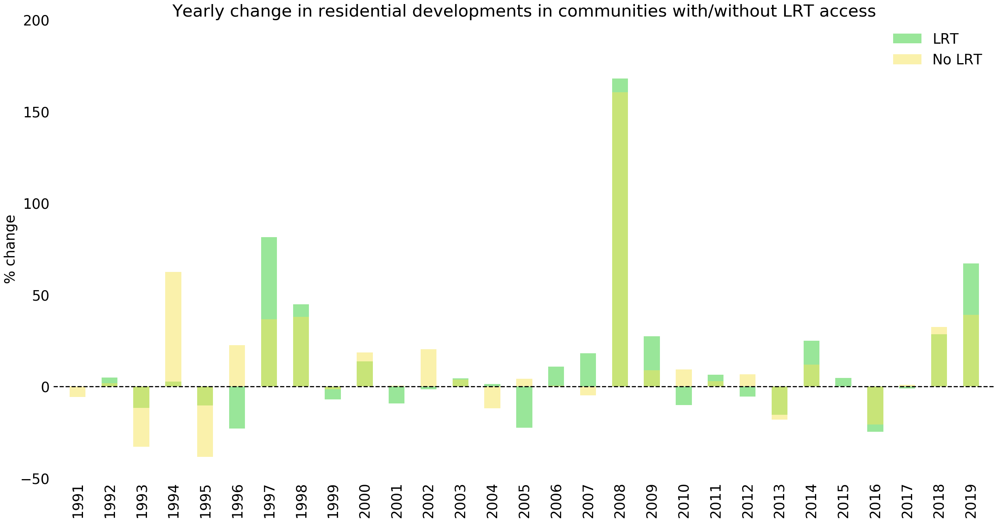

In [33]:
# Setting x/y values and colours

lrt = rates[True].tolist()
no_lrt = rates[False].tolist()
years = rates[False].index.tolist()

green = (153/255,230/255,153/255)
yellow = (247/255, 228/255, 89/255)

# Setting the positioning parameters for each bar

n = len(years)
bar_pos = np.arange(n) + 0.75
tick_pos = range(1, n+1)

# Importing matplotlib and defining a re-usable function to adapt our graph's appearance

import matplotlib.pyplot as plt
%matplotlib inline

def simplify(axis):
    """Removes unnecessary spines, and ticks from axis object"""
    axis.tick_params(bottom=False, top=False, left=False, right=False)
    axis.spines["right"].set_visible(False)    
    axis.spines["left"].set_visible(False)
    axis.spines["top"].set_visible(False)    
    axis.spines["bottom"].set_visible(False)
    return axis

# Plotting the graph

plt.figure(figsize=(30,15), dpi=100)
plt.rcParams.update({'font.size': 25})
plt.bar(bar_pos, lrt, width=0.5, label='LRT', color=green)
plt.bar(bar_pos, no_lrt, width=0.5, label='No LRT', color=yellow,  alpha=0.5)
plt.title('Yearly change in residential developments in communities with/without LRT access')
plt.ylabel('% change')
plt.ylim(-50, 200)
plt.xlim(0, 29.5)
plt.axhline(0,linestyle='dashed',linewidth=2,color='black')
plt.legend(frameon=False)

# Adapting the graph

ax = plt.gca()
ax.set_xticks(bar_pos)
ax.set_xticklabels(years, rotation=90)
simplify(ax)

plt.show()

<b>Conclusion:</b> This bar graph shows that, in some years, there are some differences between LRT and non-LRT communities. Overall, however, no clear pattern favouring one or the other emerges. Therefore, I cannot generally conclude that communities with LRT access are generally more sought-after. This suggests that factors other than LRT access greatly influence where residential development happens.

### Fig. 2: Absolute numbers by year and category 

One problem of my analysis so far is that 1 house or 1 secondary suite were counted the same as a multi-unit building, even though the latter has more dwellings and represents a much larger financial investment. This might have distorted the analysis, so <b>I will now look at the number of developments for each category separately</b>.

In [34]:
grouped_cat = pd.pivot_table(permits_res_comm_90, values='Decision', index=['Year'],
                             columns=['Category_new', 'CTrain'] , aggfunc='count')
grouped_cat.head()

Category_new House       Multi_unit       Secondary_suite      
CTrain       False True       False True            False True 
Year                                                           
1990          71.0  21.0       53.0  20.0             NaN   NaN
1991          77.0  20.0       40.0  21.0             NaN   NaN
1992          71.0  26.0       48.0  17.0             NaN   NaN
1993          52.0  22.0       28.0  16.0             NaN   NaN
1994          84.0  27.0       46.0  12.0             NaN   NaN

In [35]:
grouped_cat.tail()

Category_new  House        Multi_unit       Secondary_suite       
CTrain        False  True       False True            False  True 
Year                                                              
2015          534.0  176.0       98.0  39.0           113.0   31.0
2016          407.0  139.0      107.0  21.0            77.0   25.0
2017          455.0  131.0       71.0  28.0            71.0   24.0
2018          450.0  127.0       80.0  32.0           261.0   76.0
2019          386.0  107.0       60.0  19.0           654.0  267.0

Now that I have aggregated the number of permits by neighbourhood type, building type and year, I can <b>plot</b> this information. I chose a <b>composite figure of three horizontal grouped bar charts for this</b>. It should allow me to quickly compare neighbourhoods and years for each type of building.

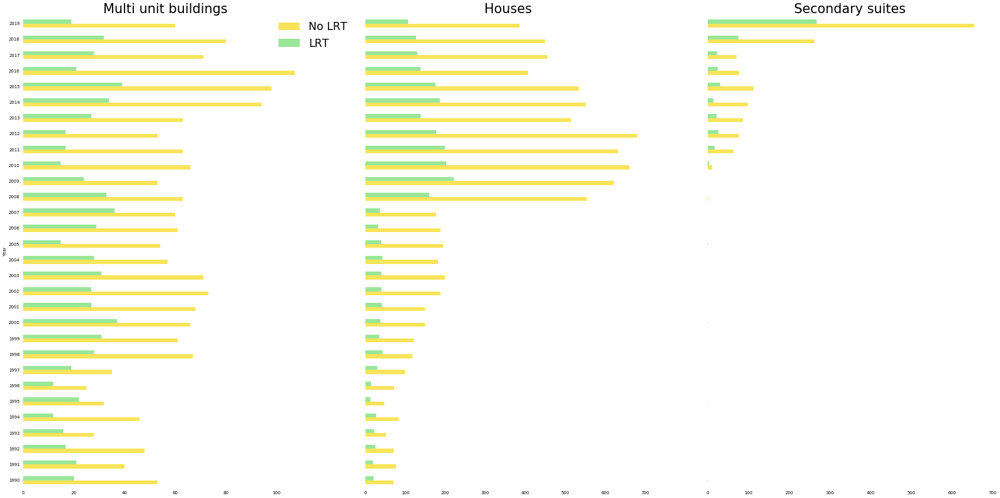

In [36]:
# Creating figure and axes
fig, (ax1, ax2,ax3) = plt.subplots(1, 3, figsize=(40, 20), dpi=50, sharey=True)
plt.rcParams.update({'font.size': 25})

# Plotting multi unit
grouped_cat['Multi_unit'].plot(kind='barh',  color=[yellow, green], ax=ax1)
ax1.set_title('Multi unit buildings')
ax1.legend(loc='lower left', labels=['No LRT', 'LRT'], bbox_to_anchor= (0.88, 0.92), ncol=1, 
            borderaxespad=0, frameon=False)

# Plotting houses
grouped_cat['House'].plot(kind='barh',  color=[yellow, green], ax=ax2)
ax2.set_title('Houses')
ax2.get_legend().remove()

# Plotting secondary suites
grouped_cat['Secondary_suite'].plot(kind='barh',  color=[yellow, green], ax=ax3)
ax3.set_title('Secondary suites')
ax3.get_legend().remove()
ax3.set_xlim(0, 700)

#Adapting graph styles
simplify(ax1), simplify(ax2), simplify(ax3)

plt.show()

<b>Conclusion:</b> This graphs shows that, in total, there is a much larger number of developments in non-LRT communities. That makes sense, given that Calgary's LRT system has only two lines and, thus, doesn't serve much of the city. The number of developments rises and falls quite similarly in LRT and non-LRT communities, again suggesting that factors other than acccess to transit drive the volume of developments. Crucially, this is the same whether I look at houses or at multi unit buildings. <br>
An interesting trend to note here is the sharp rise the numbers of secondary suites in 2018 and 2019.

## Plotting the building permits on a map

### (Re-)Importing the data

In [37]:
# Re-importing cleaned data
import pandas as pd
permits_mapping = permits_res_comm_90

# Importing City of Calgary geodata
import json

with open('data/Community Boundaries.geojson') as f:
    calgary_area = json.load(f)

### Checking compatibility of geodata and permits data

In [38]:
# Extracting community names in city of City of Calgary geodata
df_comms = permits_mapping['CommunityName'].unique()

# Extracting community names in city of City of Calgary geodata
json_comms = []

for key in calgary_area['features']:
    name = key['properties']['name']
    json_comms.append(name)

In [39]:
# Checking communities in GeoJSON data, not in permits

json_remain = set(json_comms)
json_remain.difference_update(df_comms)

print(json_remain)

{'12I', '12J', '09H', '10D', '13E', 'FOOTHILLS', '13I', '12A', '09K', 'BURNS INDUSTRIAL', 'BELVEDERE', '13L', '12L', '02K', '13H', 'SKYLINE EAST', 'PINE CREEK', 'SCARBORO/ SUNALTA WEST', '01B', '13J', '12K', 'MANCHESTER INDUSTRIAL', 'VALLEYFIELD', 'EAST FAIRVIEW INDUSTRIAL', 'SOUTH AIRWAYS', '13G', '13M', '02B', '02E', '09O', 'MAYLAND', 'GLENDEER BUSINESS PARK', 'SOUTH FOOTHILLS', 'WOLF WILLOW', '10E', 'EASTFIELD', 'SECTION 23', 'ALYTH/BONNYBROOK', '05E', '03D', 'WESTWINDS', 'SADDLE RIDGE INDUSTRIAL', 'PEGASUS', '09Q', 'AURORA BUSINESS PARK', '02C', 'STONEY 2', '02F', '05D', 'STONEY 4', 'OGDEN SHOPS', 'STONEGATE LANDING', 'QUEENS PARK VILLAGE', 'MACEWAN GLEN', 'RANGEVIEW', 'STONEY 1', '01H', '13C', 'SHEPARD INDUSTRIAL', '09P', 'HIGHFIELD', 'UNIVERSITY OF CALGARY', 'KEYSTONE HILLS', '13A', 'NOSE HILL PARK', 'CANADA OLYMPIC PARK', '13D', '01I', '12C', 'MERIDIAN', 'HOTCHKISS', 'GLENMORE PARK', '01K', 'STONEY 3', '12B', 'STARFIELD', 'GOLDEN TRIANGLE', 'HOMESTEAD', 'CALGARY INTERNATIONAL AI

In [40]:
# Adjusting CommunityName column in permits data

comm_dict = {
    'NORTH GLENMORE' : 'GLENMORE PARK',
    'PARKHILL/STANLEY PARK' : 'PARKHILL',
    'CONNAUGHT' : 'BELTLINE',
    'CFB - LINCOLN PARK PMQ' : 'LINCOLN PARK',
    'CFB - CURRIE' : 'CURRIE BARRACKS',
    'VICTORIA PARK' : 'BELTLINE',
    'SCARBORO/SUNALTA WEST' : 'SCARBORO/ SUNALTA WEST',
    'MOUNT ROYAL LOWER' : 'LOWER MOUNT ROYAL',
    'MACEWAN' : 'MACEWAN GLEN' 
}

permits_mapping['CommunityName'].replace(comm_dict, inplace=True)

### Fig. 3: Visualising with a point map

(N.B.: Code has been commented since it turns out not to be a useful map, but takes long to load)

In [41]:
import folium

# Creating base map of Calgary
point_map = folium.Map(location=[51.0447,-114.0719], tiles='Stamen Toner', zoom_start=10)

# Overlaying community boundaries

style_comm = {'fillColor': '#9a9a9a', 'color': '#9a9a9a'} 
folium.GeoJson(calgary_area, style_function = lambda x:style_comm).add_to(point_map)

In [42]:
# Making a basic point map, i.e. plotting each permit as a point 

for i,row in permits_mapping.iterrows():
    folium.CircleMarker(
        (row.Latitude,row.Longitude), 
        radius=1, weight=1, color='black',
        fill_color='black', fill_opacity=.25).add_to(point_map)

point_map.save('fig_3_yyc_permit_point_map.html')
point_map

A point map is not suited for this visualisation, because it is too crowded. Will try choropleth map next. This basically plots the density per community.

### Fig. 4: Visualising with a choropleth map

In [43]:
import folium

# Aggregating by community name and project type

by_comm = permits_mapping.groupby('CommunityName').count()['Decision'].rename('Count')

# Creating basic map of Calgary and its communities
yyc_map2 = folium.Map(location=[51.0447,-114.0719], tiles='Stamen Toner', zoom_start=10)

# Plotting density of permits

import numpy as np
bins = np.linspace(1, by_comm.max(), 10).round().tolist()

permits_choro = folium.Choropleth(
    geo_data=calgary_area,
    data=by_comm,
    key_on='feature.properties.name',
    fill_color='Blues',
    fill_opacity=.8,
    line_opacity=0.2,
    legend_name='Permits',
    nan_fill_color = 'white',
    nan_fill_opacity=0,
    bins = bins,
    highlight=True
).add_to(yyc_map2)

folium.GeoJsonTooltip(fields=['name'], labels=False).add_to(permits_choro.geojson)

yyc_map2

#### Adding train stations and train lines

In [44]:
# Loading stations data
stations = pd.read_csv('data/Transit_LRT_Stations.csv')

# Converting coordinates stored as string to tuple
stations['location'] = stations['location'].apply(eval)

stations.head()

,STATIONNAM,LEG,DIRECTION,DIST_NB,DIST_SB,DIST_EB,DIST_WB,ROUTE,STATUS,longitude,latitude,location
0,Chinook,SW,North/South,2299.0,2200.0,0.0,0.0,201,Current,-114.065809,50.996808,"(50.996807857737046, -114.06580853211398)"
1,Zoo,NE,East/West,0.0,0.0,1379.0,1100.0,202,Current,-114.024856,51.047369,"(51.04736922517619, -114.02485607969437)"
2,6 St SW,DTEastbnd,East,0.0,0.0,414.0,410.0,201/202,Current,-114.075085,51.046773,"(51.04677318388097, -114.07508481556182)"
3,Sunalta,West,West/East,NaN,NaN,NaN,NaN,202,Current,-114.099135,51.044818,"(51.04481812949617, -114.09913462976633)"
4,Victoria Park / Stampede,SW,North/South,1027.0,725.0,0.0,0.0,201,Current,-114.058308,51.038580,"(51.03858013717659, -114.05830814657534)"


In [45]:
# Extracting stations on 'Red Line'. Sorting North/South, since this is the primary direction the line runs
red_line = stations[(stations.ROUTE == '201') | (stations.ROUTE == '201/202')].sort_values(['latitude'])

# Sorting failed for downtown stations. Manually reordering downtown Red Line stations
red_adj_index = [13, 19, 25, 15, 24, 40, 45, 0, 32, 37, 4, 31, 27, 18, 20, 7, 26, 2, 11, 22, 35, 9, 21, 46, 33, 43, 6, 10, 14]
red_line = red_line.reindex(red_adj_index)

#  Drawing train line
loc_red = red_line['location'].tolist()
folium.PolyLine(loc_red,
                color='red',
                weight=3,
                tooltip = 'Red Line').add_to(yyc_map2)

# Plotting stations
for i,row in red_line.iterrows():
    folium.CircleMarker(
        row.location, 
        radius=2, 
        weight=2,
        color='black',
        tooltip = row.STATIONNAM,
        fill_color='black', fill_opacity=1).add_to(yyc_map2)

In [46]:
# Extracting stations on 'Blue Line'. Sorting East/West, since this is the primary direction the line runs
blue_line = stations[(stations.ROUTE == '202') | (stations.ROUTE == '201/202')].sort_values(['longitude'])

# Sorting failed for downtown stations. Manually reordering downtown Red Line stations
blue_adj_index = [38, 34, 30, 41, 17, 3, 36, 28, 22, 11, 2, 26, 7, 20, 18, 27, 31, 44, 1, 39, 29, 8, 12, 16, 42, 23, 5]
blue_line = blue_line.reindex(blue_adj_index)

# Drawing train line
loc_blue = blue_line['location'].tolist()
folium.PolyLine(loc_blue,
                color='blue',
                weight=3,
                tooltip = 'Blue Line').add_to(yyc_map2)

# Plotting stations
for i,row in blue_line.iterrows():
    folium.CircleMarker(
        row.location, 
        radius=2, 
        weight=2,
        color='black',
        tooltip = row.STATIONNAM,
        fill_color='black', fill_opacity=1).add_to(yyc_map2)
    
yyc_map2.save('fig_4_yyc_permits_choropleth.html')
yyc_map2

<b>Conclusion:</b> This map confirms my previous finding that communities with <i>direct</i> LRT access don't have greater levels of residential development than communities without LRT access. Interestingly though, the choropleth map reveals a trend that wasn't captured in the binary train/no-train bar graphs shown above: It seems that there is more residential development in communities <i>around</i> the LRT rather than on the LRT. A reason for this could be that these communities are more affordable, and therefore more lucrative to develop in.